In [28]:
import pandas as pd
import requests
from bs4 import BeautifulSoup
import time
import pickle
from urllib.parse import urlparse
import tldextract

In [18]:
current_timestamp = time.time()
print("Timestamp:", round(current_timestamp))

Timestamp: 1709884321


In [5]:
with open('../../dataset/dataset_A_05_2020_p1.pickle', 'rb') as f:
    x = pickle.load(f)
html_frame=pd.DataFrame.from_dict(x)
html_frame=html_frame.T
html_frame=html_frame.reset_index()
html_frame.drop(columns=['src'],inplace=True)
html_frame.drop(columns=['dom'],inplace=True)
html_frame.rename(columns = {'status':'phishing'}, inplace = True)
html_frame.rename(columns = {'index':'url'}, inplace = True)
#html_frame.rename(columns = {'dom':'website'}, inplace = True)
html_frame=html_frame.replace({'legitimate': 0, 'phishing': 1})

In [6]:
html_frame.loc[0]['url']

'http://www.crestonwood.com/router.php'

In [28]:
len(html_frame)

100




<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">
<html xmlns="http://www.w3.org/1999/xhtml">
<head><link rel="shortcut&#32;icon" href="images/favicon.ico" type="images/x-icon" /><link rel="icon" href="images/favicon.ico" type="images/x-icon" /><meta http-equiv="Content-Type" content="text/html;&#32;charset=utf-8" /><meta http-equiv="X-UA-Compatible" content="IE=Edge,chrome=1" /><meta name="viewport" content="width=device-width,&#32;initial-scale=1.0" /><title>
	Official Website of Rajiv Gandhi Institute of Petroleum Technology, Jais, Amethi, India.
</title><link rel="shortcut&#32;icon" href="favicon.ico" />

<!-- Include all below css library for Dynamic Work and should not be removed from here. -->

<base href='https://rgipt.ac.in' />
<style type="text/css">
@import url("Scripts/jquery-ui.css");
 @import url("site/writereaddata/config/sitecss.css");
</style>
<link href='site/writereaddata/config/pagescssstyles
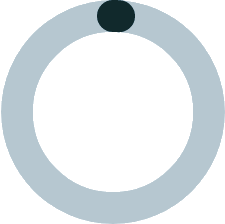

In [52]:
html_frame['website']=html_frame['url'].apply(lambda x: collectdata(x))

In [54]:
filt=html_frame['website'] != 0

In [53]:
html_frame

,url,phishing,website
0,http://www.crestonwood.com/router.php,0,0
1,http://rgipt.ac.in,0,rgipt_1709894682721835.html
2,http://vamoaestudiarmedicina.blogspot.com/,0,blogspot_1709894684842108.html
3,https://www.astrologyonline.eu/Astro_MemoNew/P...,0,astrologyonline_1709894689061717.html
4,http://html.house/l7ceeid6.html,1,0
...,...,...,...
95,https://www.youtube.com/user/PING,0,youtube_1709895123874508.html
96,http://www.instohelp.com/assets_flight/libs/bo...,1,instohelp_1709895126145362.html
97,https://learn.sparkfun.com/tutorials/16,0,sparkfun_1709895129060467.html
98,https://www.workiva.com/,0,workiva_1709895131119514.html


In [55]:
test=html_frame[filt]

In [57]:
test

,url,phishing,website
1,http://rgipt.ac.in,0,rgipt_1709894682721835.html
2,http://vamoaestudiarmedicina.blogspot.com/,0,blogspot_1709894684842108.html
3,https://www.astrologyonline.eu/Astro_MemoNew/P...,0,astrologyonline_1709894689061717.html
5,https://www.missfiga.com/,0,missfiga_1709894695091588.html
6,http://wave.progressfilm.co.uk/time3/?logon=my...,1,progressfilm_1709894701938875.html
...,...,...,...
94,https://www.slideshare.net/ashamsvk/project-re...,0,slideshare_1709895121019774.html
95,https://www.youtube.com/user/PING,0,youtube_1709895123874508.html
96,http://www.instohelp.com/assets_flight/libs/bo...,1,instohelp_1709895126145362.html
97,https://learn.sparkfun.com/tutorials/16,0,sparkfun_1709895129060467.html


In [35]:
html_frame

,url,phishing,website
0,http://www.crestonwood.com/router.php,0,0
1,http://rgipt.ac.in,0,rgipt_1709887276.html
2,http://vamoaestudiarmedicina.blogspot.com/,0,blogspot_1709887279.html
3,https://www.astrologyonline.eu/Astro_MemoNew/P...,0,astrologyonline_1709887284.html
4,http://html.house/l7ceeid6.html,1,0
...,...,...,...
95,https://www.youtube.com/user/PING,0,youtube_1709887748.html
96,http://www.instohelp.com/assets_flight/libs/bo...,1,instohelp_1709887750.html
97,https://learn.sparkfun.com/tutorials/16,0,sparkfun_1709887753.html
98,https://www.workiva.com/,0,workiva_1709887755.html


In [33]:
collectdata(html_frame.loc[1]['url'])



<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">
<html xmlns="http://www.w3.org/1999/xhtml">
<head><link rel="shortcut&#32;icon" href="images/favicon.ico" type="images/x-icon" /><link rel="icon" href="images/favicon.ico" type="images/x-icon" /><meta http-equiv="Content-Type" content="text/html;&#32;charset=utf-8" /><meta http-equiv="X-UA-Compatible" content="IE=Edge,chrome=1" /><meta name="viewport" content="width=device-width,&#32;initial-scale=1.0" /><title>
	Official Website of Rajiv Gandhi Institute of Petroleum Technology, Jais, Amethi, India.
</title><link rel="shortcut&#32;icon" href="favicon.ico" />

<!-- Include all below css library for Dynamic Work and should not be removed from here. -->

<base href='https://rgipt.ac.in' />
<style type="text/css">
@import url("Scripts/jquery-ui.css");
 @import url("site/writereaddata/config/sitecss.css");
</style>
<link href='site/writereaddata/config/pagescssstyles/

'rgipt_1709887218.html'

In [20]:
x = requests.get('http://www.crestonwood.com/router.php')
print(x.text)
print(len(x.text))


0


In [43]:
time.time() % 1

0.9032113552093506

In [49]:
print(time.time() * 10**6)
print(time.time() % 1)

1709894601220113.5
0.22042393684387207


In [29]:
tldextract.extract('http://www.crestonwood.com/router.php').domain

'crestonwood'

In [51]:
def collectdata(url):
    try:
        x = requests.get(url)
        print(x.text)
        if(len(x.text) > 0):
            filename=tldextract.extract(url).domain+'_'+str(round(time.time() * 10**6))+'.html'
            with open('files/'+filename, 'wb') as f:
                f.write(x.content)
            return filename
            #print(filename)
        else:
            return 0
#         with open('files/'+filename, 'wb') as f:
#             f.write(x.content)
#         return filename
    except:
        return 0
# #soup = BeautifulSoup(x.text, 'html.parser',multi_valued_attributes=None)

#print(soup.prettify())

#print(x.text)

In [62]:
test['website']

1               rgipt_1709894682721835.html
2            blogspot_1709894684842108.html
3     astrologyonline_1709894689061717.html
5            missfiga_1709894695091588.html
6        progressfilm_1709894701938875.html
                      ...                  
94         slideshare_1709895121019774.html
95            youtube_1709895123874508.html
96          instohelp_1709895126145362.html
97           sparkfun_1709895129060467.html
98            workiva_1709895131119514.html
Name: website, Length: 88, dtype: object

<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">
<html xmlns="http://www.w3.org/1999/xhtml">
 <head>
  <link href="images/favicon.ico" rel="shortcut icon" type="images/x-icon"/>
  <link href="images/favicon.ico" rel="icon" type="images/x-icon"/>
  <meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
  <meta content="IE=Edge,chrome=1" http-equiv="X-UA-Compatible"/>
  <meta content="width=device-width, initial-scale=1.0" name="viewport"/>
  <title>
   Official Website of Rajiv Gandhi Institute of Petroleum Technology, Jais, Amethi, India.
  </title>
  <link href="favicon.ico" rel="shortcut icon"/>
  <!-- Include all below css library for Dynamic Work and should not be removed from here. -->
  <base href="https://rgipt.ac.in"/>
  <style type="text/css">
   @import url("Scripts/jquery-ui.css");
 @import url("site/writereaddata/config/sitecss.css");
  </style>
  <link href="site/writereaddata/config/pag

<!DOCTYPE html>
<html lang="en-us">
 <head>
  <meta charset="utf-8"/>
  <title>
   What's a Good Email Open Rate &amp; Click Rate? [Benchmark Data]
  </title>
  <link href="https://blog.hubspot.com/hubfs/HubSpot_Logos/HubSpot-Inversed-Favicon.png" rel="shortcut icon"/>
  <meta content="Ever wonder what a good open and click rate is for email marketing? Check out this benchmark data to find out." name="description"/>
  <meta content="width=device-width, initial-scale=1" name="viewport"/>
  <meta content="Ever wonder what a good open and click rate is for email marketing? Check out this benchmark data to find out." property="og:description"/>
  <meta content="What's a Good Email Open Rate &amp; Click Rate? [Benchmark Data]" property="og:title"/>
  <meta content="Ever wonder what a good open and click rate is for email marketing? Check out this benchmark data to find out." name="twitter:description"/>
  <meta content="What's a Good Email Open Rate &amp; Click Rate? [Benchmark Data]" name=

/home/selenium/anaconda3/envs/testenv/lib/python3.12/html/parser.py:171: XMLParsedAsHTMLWarning: It looks like you're parsing an XML document using an HTML parser. If this really is an HTML document (maybe it's XHTML?), you can ignore or filter this warning. If it's XML, you should know that using an XML parser will be more reliable. To parse this document as XML, make sure you have the lxml package installed, and pass the keyword argument `features="xml"` into the BeautifulSoup constructor.
  k = self.parse_starttag(i)


<?xml version="1.0" encoding="UTF-8"?>
<error>
 <code>
  NoSuchBucket
 </code>
 <message>
 </message>
 <bucketname>
  documentos
 </bucketname>
 <requestid>
  tx00000cf317178b15edb58-0065eaece3-ae552aa-sfo2b
 </requestid>
 <hostid>
  ae552aa-sfo2b-sfo2-zg02
 </hostid>
</error>

<!DOCTYPE html>
<html lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="width=device-width, initial-scale=1" name="viewport"/>
  <title>
   Service Unavailable
  </title>
  <link href="/css/app.css?id=72c2f18cb3ca08acc598" rel="stylesheet"/>
 </head>
 <body>
  <section class="py-8 text-center h-screen bg-white">
   <div class="mx-auto h-full flex items-center justify-center flex-col pb-16">
    <img alt="Service Unavailable" class="mb-8 mx-auto" height="250,46" src="/img/error.svg?id=78c8d5a8de4abbe62119" width="300"/>
    <h2 class="text-3xl mb-2 font-heading mb-4">
     Service Unavailable
    </h2>
    <p class="mb-8 text-gray-500 text-xl px-6">
     Service Unavailable
    </p>
    <div>
     <sp
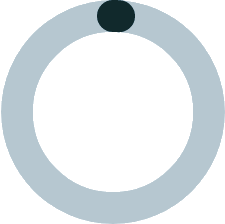

1     [\n, html PUBLIC "-//W3C//DTD XHTML 1.0 Transi...
2     [html, \n, [\n, [\n, <link href="https://www.b...
3     [[], [],  ,  devo ricaricare mootools-1.4.5.js...
5     [HTML PUBLIC "-//W3C//DTD HTML 4.01 Transition...
6     [html, \n, [\n, [\n, <meta content="utf-8" htt...
                            ...                        
94    [html, [[\n          performance.mark('gtm.sta...
95    [html, [[<script data-id="_gd" nonce="WvgGseFs...
96                                                 [[]]
97    [html, \n, [\n, [\n, <meta charset="utf-8"/>, ...
98    [HTML PUBLIC "-//W3C//DTD HTML 4.01 Transition...
Name: website, Length: 88, dtype: object

In [63]:
test['website'].apply(lambda x: get_html(x))

In [59]:
def get_html(htmlfile):
    with open('files/'+htmlfile) as fp:
        soup = BeautifulSoup(fp, 'html.parser',multi_valued_attributes=None)
        print(soup.prettify())
        return soup    

In [14]:
test=get_html('test.html')

In [15]:
test.prettify()

<!DOCTYPE html>
 <html lang="de"> <head> <meta charset="utf-8"/> <meta content="ie=edge" http-equiv="x-ua-compatible"/> <meta content="width=device-width, initial-scale=1" name="viewport"/> <meta content="Der Online-Auftritt der Kronen Zeitung. Aktuelle Nachrichten, Wetterinformationen, Horoskop und Services rund um Politik, Sport, Stars &amp; Society und Gesundheit." name="description"/> <meta content="startseite" name="cXenseParse:taxonomy"><link href="https://www.krone.at/" rel="canonical"/><link href="//api.krone.at/v1/rss/rssfeed-google.xml?id=2311992" rel="alternate" title="RSS Feed for krone.at" type="application/rss+xml"> <meta content="true" name="krn-output-ad"/> <meta content="homepage" name="krn-ressort-adunit"/> <meta content="863" name="krn-ressort-id"/> <meta content="startseite" name="krn-ressort-slug"/> <meta content="startseite" name="krn-ressort-slug_hierarchical"/> <meta content="1977687" name="krn-template-id"/> <meta content="1891282" name="krn-oewa-rule-id"/> <li

In [ ]:
def datacollector(filename):
    outputdataframe = pd.DataFrame()
